## Data Preprocessing

○ Handle missing data through imputation or removal (e.g., mean imputation, mode imputation, dropping rows).

○ Address outliers using statistical methods or domain knowledge (e.g., z-score thresholding, interquartile range).

○ Normalize or scale features as needed for analysis (e.g., Min-Max scaling, standardization).

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#mount the drive
from google.colab import drive
drive.mount('/content/drive')

import kagglehub
from kagglehub import KaggleDatasetAdapter


file_path = "/content/drive/MyDrive/datasets/1/job_descriptions.csv"


MessageError: Error: credential propagation was unsuccessful

In [ ]:
df_jobdes = pd.read_csv(file_path)


In [ ]:
df_jobdes.head()

In [ ]:
df_jobdes.shape

In [ ]:
columns_to_remove = [ 'location', 'Benefits']
df_jobdes = df_jobdes.drop(columns=columns_to_remove)
df_jobdes.head()

In [ ]:
#1.identify missing values
df_jobdes.isnull().sum()

In [ ]:
#Company profile have lots of null value

null_values = df_jobdes.loc[df_jobdes['Company Profile'].isnull()]
(null_values)

In [ ]:
#extracting only Company Profile to handle missing data

import json

# Step 2: Define a function to parse the JSON string into a dictionary
def parse_json_string(json_str):
    try:
        # Attempt to parse the JSON string
        return json.loads(json_str)
    except (TypeError, json.JSONDecodeError):
        # If it's not a valid JSON string or is a float, return NaN
        return np.nan

# Step 3: Parse the JSON string stored in the 'company_info' column
df_jobdes['parsed_info'] = df_jobdes['Company Profile'].apply(parse_json_string)


expanded_info = df_jobdes['parsed_info'].apply(pd.Series)


In [ ]:
#saved the csv to drive for future use
from google.colab import drive
drive.mount('/content/drive')

expanded_info.to_csv('/content/drive/MyDrive/datasets/expanded_info.csv', index=False)

In [ ]:
expanded_info.head()

In [ ]:
expanded_info.isnull().sum()

In [ ]:
#dropping unwanted columns
columns_remove = [ 'Ticker', 'State', 'City', 'Zip']
sub_df = expanded_info.drop(columns=columns_remove)
sub_df.head()

In [ ]:
df_jobdes= pd.concat([df_jobdes, sub_df], axis=1)
df_jobdes.head()

In [ ]:
df_jobdes = df_jobdes.loc[:, ~df_jobdes.columns.duplicated()]


In [ ]:
columns_remove = [  'parsed_info']
df_jobdes = df_jobdes.drop(columns=columns_remove)
df_jobdes.head()

In [ ]:
df_jobdes.isnull().sum()


In [ ]:
#dropping Company profile since their keys are treated as separate attributes
df_jobdes = df_jobdes.drop(columns=['Company Profile'])
df_jobdes.head()

In [ ]:
df=df_jobdes
missing_values = df[['Company', 'Sector', 'Industry', 'Website']].isnull().sum()
print("Missing values:\n", missing_values)


In [ ]:
#categorical column identification
categorical_cols = ['Work Type', 'Preference', 'Job Title', 'Company', 'Sector']
for col in categorical_cols:
    df[col] = pd.Categorical(df[col])
df.head()

In [ ]:
#convert the salary to numerical since it contains string

import re

def parse_value(s):
    """
    Convert a string currency value like '59K', '2.5M', or '750' into a numeric value.
    """
    # Remove dollar sign and any extra whitespace.
    s = s.replace("$", "").strip()

    pattern = r"([\d,.]+)([kKmMbB]?)"
    match = re.match(pattern, s)
    if not match:
        return None
    number_str, suffix = match.groups()
    # Remove commas and convert to float
    number_str = number_str.replace(",", "")
    try:
        value = float(number_str)
    except ValueError:
        return None
    # Apply multiplier based on suffix
    if suffix.lower() == 'k':
        value *= 1000
    elif suffix.lower() == 'm':
        value *= 1000000
    elif suffix.lower() == 'b':
        value *= 1000000000
    return value

def parse_salary_range(salary_range):
    """
    Convert a salary range string (e.g., '$59K-$99K') into two numeric values.
    """
    if not isinstance(salary_range, str):
        return None, None
    # Split the range on the hyphen
    parts = salary_range.split("-")
    if len(parts) != 2:
        return None, None
    start_str, end_str = parts[0].strip(), parts[1].strip()
    start_val = parse_value(start_str)
    end_val = parse_value(end_str)
    return start_val, end_val

df = df_jobdes

df[['Salary Starts From', 'Salary To']] = df['Salary Range'].apply(lambda x: pd.Series(parse_salary_range(x)))

# Check the result
print(df.head())


In [ ]:
df.drop(columns=['Salary Range'], inplace=True)
df.info()

In [ ]:
#calclutaing average salary to keep the computation simple
df['Average Salary'] = (df['Salary Starts From'] + df['Salary To']) / 2
df.head()

In [ ]:
#transforming the experience range to numerical and taking average
def extract_experience_range(experience_str):
    """Extracts the numeric experience range from a string.

    Args:
        experience_str: The experience string (e.g., '5 to 15 years').

    Returns:
        A tuple of (start_year, end_year) as integers, or (None, None) if not found.
    """
    match = re.search(r'(\d+)\s*to\s*(\d+)\s*years?', experience_str, re.IGNORECASE)
    if match:
        return int(match.group(1)), int(match.group(2))
    else:
        return None, None

# Apply the function to create new columns
df[['Experience_Start', 'Experience_End']] = df['Experience'].apply(lambda x: pd.Series(extract_experience_range(x)))

# Calculate the average experience
df['Experience_Avg'] = (df['Experience_Start'] + df['Experience_End']) / 2

# Update the 'Experience' column with the average
df['Experience'] = df['Experience_Avg']


df.drop(columns=['Experience_Start', 'Experience_End', 'Experience_Avg'], inplace=True)

In [ ]:
df.info()

In [ ]:
df['Experience']


In [ ]:
#Filling missing values
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='most_frequent')
imputer.fit(df[['Sector']])

df['Sector'] = imputer.transform(df[['Sector']]).ravel()

In [ ]:
df.info()

In [ ]:
# Fill NaN values in df_jobdes with "Not specified"

categorical_cols = df_jobdes.select_dtypes(include=['category']).columns
# Add the new category to each categorical column
for col in categorical_cols:
    df_jobdes[col] = df_jobdes[col].cat.add_categories(["Not explicitly specified here"])


df_jobdes = df_jobdes.fillna("Not explicitly specified here")

# Display the first few rows to check the result
df_jobdes.head()

In [ ]:
df_jobdes.isnull().sum()

In [ ]:
df.head()

In [ ]:
categorical_cols = ['Qualifications']
for col in categorical_cols:
    df[col] = pd.Categorical(df[col])
df.head()

In [ ]:
#detecting outliers
def find_outliers_zscore(data, threshold=3):

  z_scores = np.abs((data - data.mean()) / data.std())
  outliers = data[z_scores > threshold]
  return outliers

def find_outliers_iqr(data):

  Q1 = data.quantile(0.25)
  Q3 = data.quantile(0.75)
  IQR = Q3 - Q1
  lower_bound = Q1 - 1.5 * IQR
  upper_bound = Q3 + 1.5 * IQR
  outliers = data[(data < lower_bound) | (data > upper_bound)]
  return outliers


numerical_cols = ['Average Salary', 'Experience', 'Company Size']

# Find outliers using Z-score method
for col in numerical_cols:
  outliers_zscore = find_outliers_zscore(df[col])
  print(f"Outliers in {col} (Z-score):\n{outliers_zscore}\n")

# Find outliers using IQR method
for col in numerical_cols:
  outliers_iqr = find_outliers_iqr(df[col])
  print(f"Outliers in {col} (IQR):\n{outliers_iqr}\n")

In [ ]:
def visualize_outliers(data, outliers_zscore, outliers_iqr, column_name):

    plt.figure(figsize=(10, 6))

    # Box plot
    plt.subplot(1, 2, 1)
    sns.boxplot(x=data[column_name])
    plt.title(f'Box Plot of {column_name}')

    plt.subplot(1, 2, 2)
    plt.scatter(data.index, data[column_name], label='Data')
    plt.scatter(outliers_zscore.index, outliers_zscore, color='red', label='Z-score Outliers')
    plt.scatter(outliers_iqr.index, outliers_iqr, color='orange', label='IQR Outliers')
    plt.title(f'Scatter Plot of {column_name} with Outliers')
    plt.xlabel('Index')
    plt.ylabel(column_name)
    plt.legend()

    plt.tight_layout()
    plt.show()


numerical_cols = ['Average Salary', 'Experience', 'Company Size']

for col in numerical_cols:
    outliers_zscore = find_outliers_zscore(df[col])
    outliers_iqr = find_outliers_iqr(df[col])
    visualize_outliers(df, outliers_zscore, outliers_iqr, col)

In [ ]:
from sklearn.preprocessing import MinMaxScaler

numerical_cols = ['Average Salary', 'Experience', 'Company Size']

# Create a MinMaxScaler object
scaler = MinMaxScaler()

# Fit the scaler to the data and transform it
df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

In [ ]:
from sklearn.preprocessing import StandardScaler

numerical_cols = ['Average Salary', 'Experience', 'Company Size']

# Create a StandardScaler object
scaler = StandardScaler()

# Fit the scaler to the data and transform it
df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

In [ ]:
df.head()

In [ ]:
# Identify columns with all zeros
zero_cols = df.columns[(df == 0).all()]

# Drop the identified columns
df = df.drop(columns=zero_cols)

In [ ]:
df.info()

In [ ]:
#save


file_path = '/content/drive/MyDrive/datasets/processed_job_descriptions.csv'

# Save the DataFrame to the specified path
df.to_csv(file_path, index=False)

##Exploratory Data Analysis (EDA)

○ Use descriptive statistics (e.g., mean, median, standard deviation) to summarize the dataset.

○ Create visualizations (e.g., histograms, scatter plots, box plots) to identify patterns, trends, and relationships.

○ Identify potential issues such as multicollinearity or skewed distributions using correlation analysis and statistical tests.

In [ ]:
#1. top 50 jobs
top_50_jobs = df['Job Title'].value_counts().nlargest(50).index  # Get top 50 job titles
filtered_df = df[df['Job Title'].isin(top_50_jobs)]  # Filter DataFrame

In [ ]:
gender_job_distribution = pd.crosstab(filtered_df['Job Title'], filtered_df['Preference'])

# Visualize with a stacked bar chart
gender_job_distribution.plot(kind='bar', stacked=True, figsize=(12, 8))  # Adjust figsize for better readability
plt.title('Gender Distribution by Job Title (Top 50)')
plt.xlabel('Job Title')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.legend(title='Preference')
plt.tight_layout()
plt.show()

In [ ]:
# Top job titles for women (within top 50)
top_female_jobs = gender_job_distribution['Female'].sort_values(ascending=False)[:10]  # Top 10 within top 50
print("Top Job Titles for Women (Top 50):\n", top_female_jobs)

# Top job titles for men (within top 50)
top_male_jobs = gender_job_distribution['Male'].sort_values(ascending=False)[:10]  # Top 10 within top 50
print("\nTop Job Titles for Men (Top 50):\n", top_male_jobs)

In [ ]:
# Calculate proportions
gender_job_proportions = gender_job_distribution.div(gender_job_distribution.sum(axis=1), axis=0)

# Visualize with a heatmap
plt.figure(figsize=(14, 10))  # Adjust figsize for better readability
sns.heatmap(gender_job_proportions, annot=True, cmap='YlGnBu', fmt=".2f")
plt.title('Gender Proportions by Job Title (Top 50)')
plt.xlabel('Preference')
plt.ylabel('Job Title')
plt.tight_layout()
plt.show()

In [ ]:

# 1. Get top 50 experience levels
top_50_experiences = df['Experience'].value_counts().nlargest(50).index
filtered_df = df[df['Experience'].isin(top_50_experiences)]

# 2. Create crosstab for top 50 experiences
experience_work_type = pd.crosstab(filtered_df['Experience'], filtered_df['Work Type'])

# 3. Visualize with a stacked bar chart
experience_work_type.plot(kind='bar', stacked=True, figsize=(12, 8))  # Adjust figsize for better readability
plt.title('Distribution of Work Type by Experience Level (Top 50)')
plt.xlabel('Experience')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')

In [3]:
#since the ram crashed, i saved the processed csv separately and ran it for visualizations
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive
drive.mount('/content/drive')


file_path = '/content/drive/MyDrive/datasets/1/processed_job_descriptions.csv'
df = pd.read_csv(file_path)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


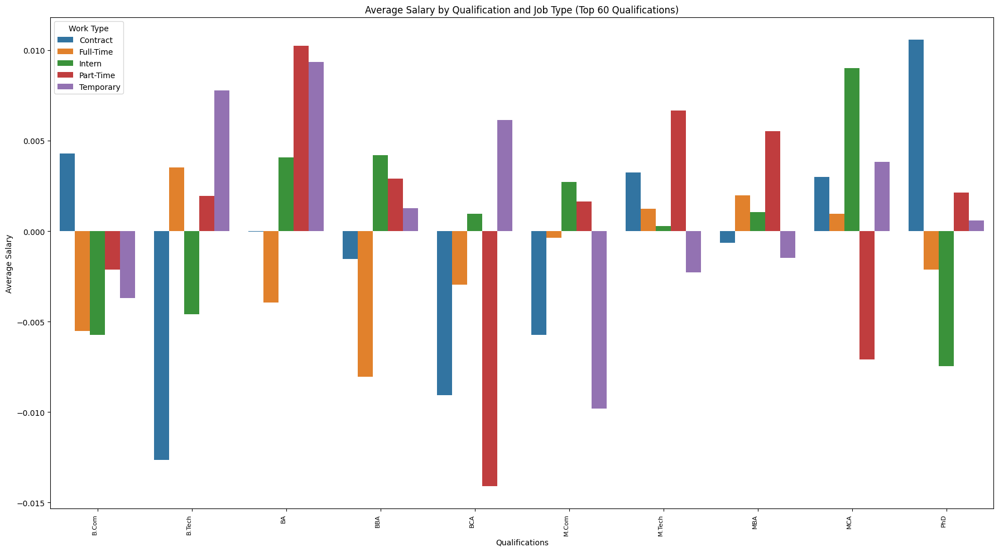

TypeError: DataFrame.pivot() takes 1 positional argument but 4 were given

In [4]:

# Get top 60 qualifications
top_60_qualifications = df['Qualifications'].value_counts().nlargest(60).index

# Filter DataFrame for top 60 qualifications
filtered_df = df[df['Qualifications'].isin(top_60_qualifications)]

# Group data by qualifications and job type, calculating average salary
qualification_job_salary = filtered_df.groupby(['Qualifications', 'Work Type'])['Average Salary'].mean().reset_index()


plt.figure(figsize=(18, 10))
sns.barplot(x='Qualifications', y='Average Salary', hue='Work Type', data=qualification_job_salary)
plt.title('Average Salary by Qualification and Job Type (Top 60 Qualifications)')
plt.xlabel('Qualifications')
plt.ylabel('Average Salary')
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.legend(title='Work Type')
plt.tight_layout()
plt.show()


qualification_job_salary_pivot = qualification_job_salary.pivot("Qualifications", "Work Type", "Average Salary")
plt.figure(figsize=(18, 10))
sns.heatmap(qualification_job_salary_pivot, annot=True, cmap='YlGnBu', fmt=".2f")
plt.title('Average Salary by Qualification and Job Type (Top 60 Qualifications - Heatmap)')
plt.xlabel('Work Type')
plt.ylabel('Qualifications')
plt.xticks(rotation=90, ha='right', fontsize=8)  # Rotate and adjust font size for x-axis labels
plt.legend(title='Work Type')
plt.tight_layout()
plt.show()

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1615940 entries, 0 to 1615939
Data columns (total 27 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   Job Id              1615940 non-null  int64  
 1   Experience          1615940 non-null  float64
 2   Qualifications      1615940 non-null  object 
 3   Country             1615940 non-null  object 
 4   latitude            1615940 non-null  float64
 5   longitude           1615940 non-null  float64
 6   Work Type           1615940 non-null  object 
 7   Company Size        1615940 non-null  float64
 8   Job Posting Date    1615940 non-null  object 
 9   Preference          1615940 non-null  object 
 10  Contact Person      1615940 non-null  object 
 11  Contact             1615940 non-null  object 
 12  Job Title           1615940 non-null  object 
 13  Role                1615940 non-null  object 
 14  Job Portal          1615940 non-null  object 
 15  Job Description

In [6]:

# Get top 60 job titles by average salary
top_60_jobs = df.groupby('Job Title')['Average Salary'].mean().nlargest(60).index

# Filter DataFrame for top 60 job titles
filtered_df = df[df['Job Title'].isin(top_60_jobs)]


job_location_salary = filtered_df.groupby(['Job Title', 'Country'])['Average Salary'].agg(['mean', 'count']).reset_index()

# Sort by average salary in descending order
job_location_salary = job_location_salary.sort_values(by=['mean'], ascending=False)

# Display the top job titles, locations, average salaries, and job counts
print(job_location_salary[['Job Title', 'Country', 'mean', 'count']])

                  Job Title                    Country      mean  count
5289    Key Account Manager                    Lao PDR  0.941204     13
3136          Event Manager                  Lithuania  0.855716     15
12054  Supply Chain Analyst            Solomon Islands  0.804797     10
5300    Key Account Manager                 Madagascar  0.798156     14
8801     Personal Assistant                     Rwanda  0.793728     15
...                     ...                        ...       ...    ...
5270    Key Account Manager                    Iceland -0.682900     10
10857       Sales Associate                El Salvador -0.711278     11
10971       Sales Associate  Sint Maarten (Dutch part) -0.745995     12
3156          Event Manager                 Mozambique -0.783156     21
3052          Event Manager                     Brunei -0.808259     16

[12960 rows x 4 columns]


<ipython-input-7-a14b30373872>:10: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


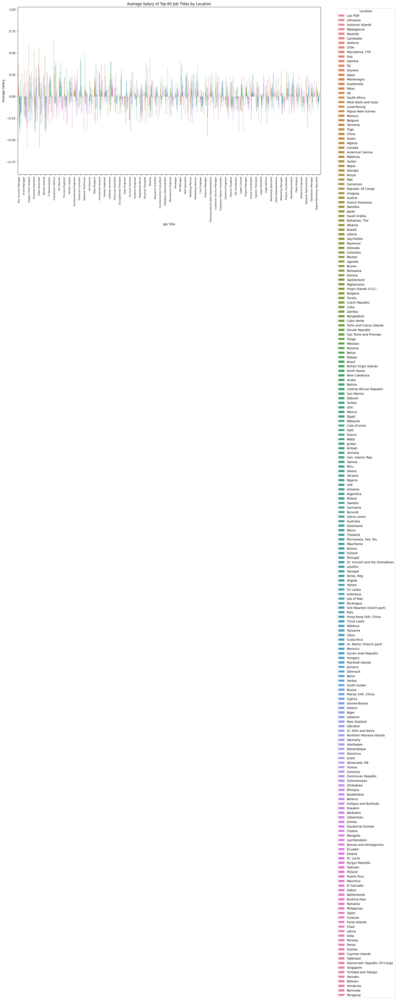

In [7]:
#visualize

plt.figure(figsize=(18, 10))  # Adjust figure size for better readability
sns.barplot(x='Job Title', y='mean', hue='Country', data=job_location_salary) # Changed hue to 'Country'
plt.title('Average Salary of Top 60 Job Titles by Location')
plt.xlabel('Job Title')
plt.ylabel('Average Salary')
plt.xticks(rotation=90, ha='right', fontsize=8)  # Rotate and adjust font size for x-axis labels
plt.legend(title='Location', bbox_to_anchor=(1.05, 1), loc='upper left') # Place legend outside the plot
plt.tight_layout()
plt.show()

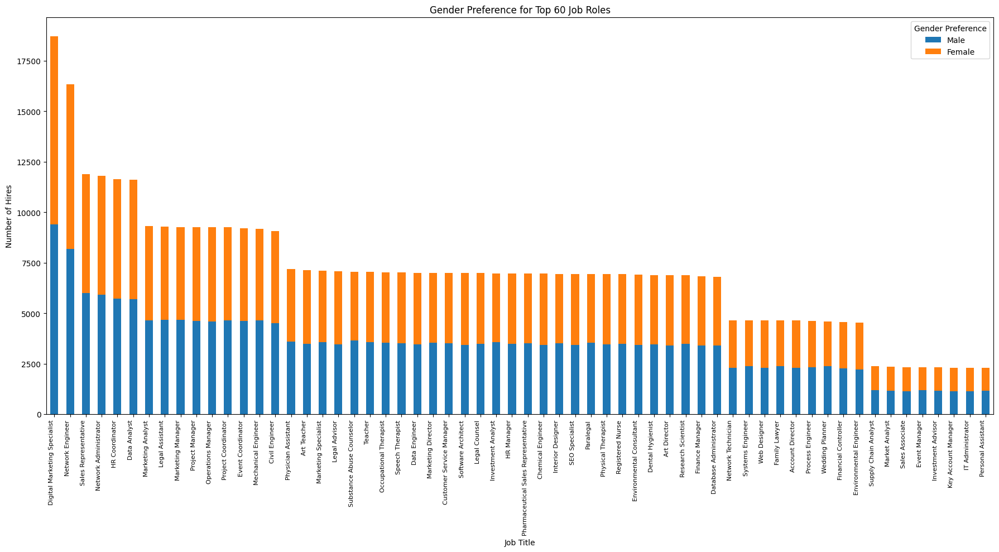

In [8]:

top_60_jobs = df.groupby('Job Title')['Average Salary'].mean().nlargest(60).index

# Filter DataFrame for top 60 job titles
filtered_df = df[df['Job Title'].isin(top_60_jobs)]

# Create a crosstab to count gender preferences for each job title
gender_job_distribution = pd.crosstab(filtered_df['Job Title'], filtered_df['Preference'])

# Filter for 'Male' and 'Female' preferences only
gender_job_distribution = gender_job_distribution[['Male', 'Female']]

# Sort by total hires (Male + Female) in descending order
gender_job_distribution['Total'] = gender_job_distribution['Male'] + gender_job_distribution['Female']
gender_job_distribution = gender_job_distribution.sort_values(by=['Total'], ascending=False)

# Visualize with a stacked bar chart
gender_job_distribution[['Male', 'Female']].plot(kind='bar', stacked=True, figsize=(18, 10))
plt.title('Gender Preference for Top 60 Job Roles')
plt.xlabel('Job Title')
plt.ylabel('Number of Hires')
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.legend(title='Gender Preference')
plt.tight_layout()
plt.show()

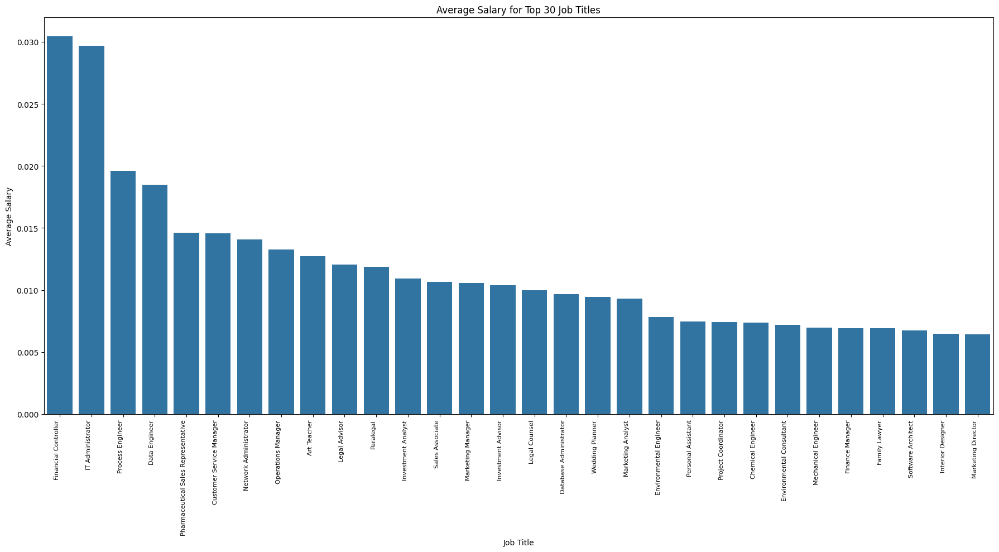

In [9]:

job_salary = df.groupby('Job Title')['Average Salary'].mean().reset_index()

# Sort by average salary in descending order
job_salary = job_salary.sort_values(by=['Average Salary'], ascending=False)

# Select top 30 job titles
top_30_jobs = job_salary.head(30)

# Create a bar plot
plt.figure(figsize=(18, 10))
sns.barplot(x='Job Title', y='Average Salary', data=top_30_jobs)
plt.title('Average Salary for Top 30 Job Titles')
plt.xlabel('Job Title')
plt.ylabel('Average Salary')
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.tight_layout()
plt.show()

<ipython-input-10-af78cd3b490c>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['Year'] = subset['Year'].astype(int)
<ipython-input-10-af78cd3b490c>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['Year'] = subset['Year'].astype(int)
<ipython-input-10-af78cd3b490c>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs

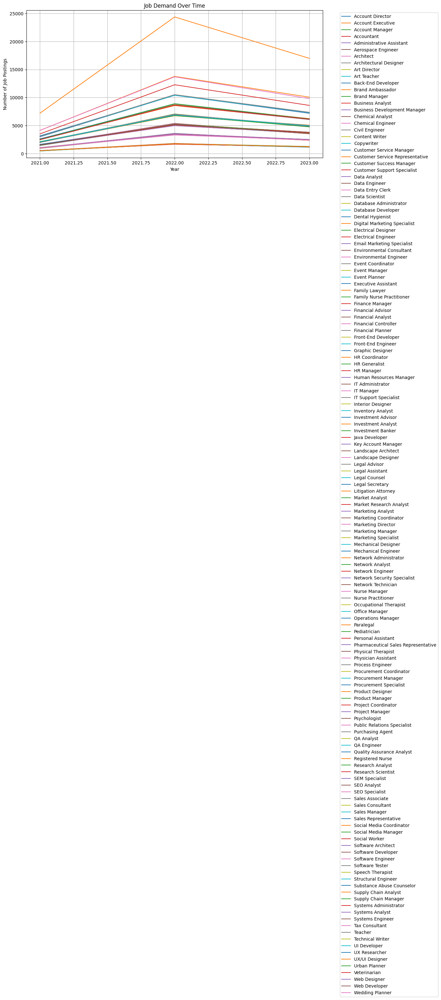

In [10]:

df['Year'] = pd.to_datetime(df['Job Posting Date']).dt.year  # Assuming 'Date' is in a format pandas can understand

# Group by Job Title and Year, and count occurrences
job_demand_over_time = df.groupby(['Job Title', 'Year'])['Job Title'].count().reset_index(name='Count')

# Visualize with a line plot
plt.figure(figsize=(12, 6))
for job_title in job_demand_over_time['Job Title'].unique():
    subset = job_demand_over_time[job_demand_over_time['Job Title'] == job_title]
    subset['Year'] = subset['Year'].astype(int)

    plt.plot(subset['Year'], subset['Count'], label=job_title)

plt.title('Job Demand Over Time')
plt.xlabel('Year')
plt.ylabel('Number of Job Postings')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

plt.grid(True)
plt.tight_layout()
plt.show()

In [11]:
!pip install plotly
import pandas as pd
import plotly.express as px


# 1. Get top 50 job titles
top_50_jobs = df['Job Title'].value_counts().nlargest(50).index
filtered_df = df[df['Job Title'].isin(top_50_jobs)]

# 2. Create a scatter mapbox using plotly.express
fig = px.scatter_mapbox(
    filtered_df,
    lat="latitude",
    lon="longitude",
    color="Job Title",
    hover_name="Job Title",
    zoom=1,
    height=600,
    width=800,
    mapbox_style="open-street-map"
)

fig.update_layout(title_text="Geographical Spread of Top 50 Job Titles")
fig.show()

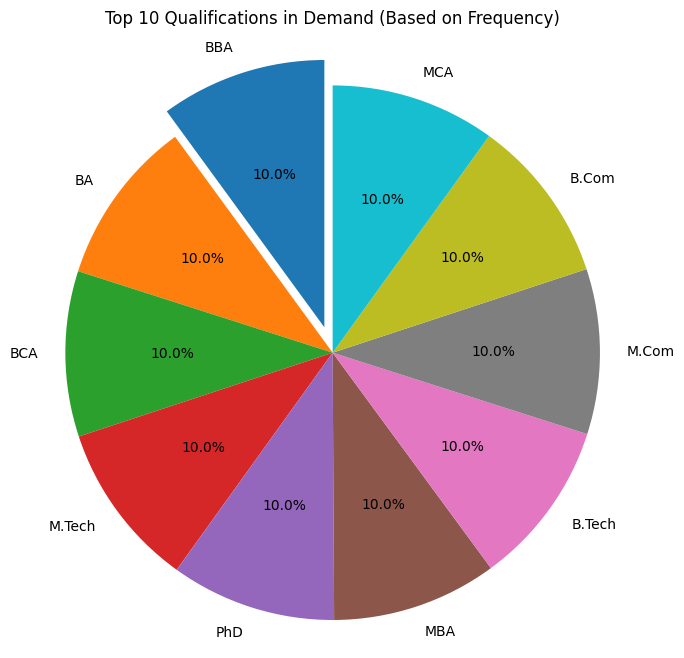

In [12]:

# 1. Get top 10 qualifications and mode
top_10_qualifications = df['Qualifications'].value_counts().nlargest(10)
mode_qualification = top_10_qualifications.index[0]

# 2. Create explode array for highlighting the mode
explode = np.zeros(len(top_10_qualifications))
explode[top_10_qualifications.index.get_loc(mode_qualification)] = 0.1

# 3. Create the pie chart with proportional slices
plt.figure(figsize=(8, 8))
plt.pie(top_10_qualifications, labels=top_10_qualifications.index, autopct='%1.1f%%', startangle=90, explode=explode)
plt.title('Top 10 Qualifications in Demand (Based on Frequency)')
plt.axis('equal')
plt.show()

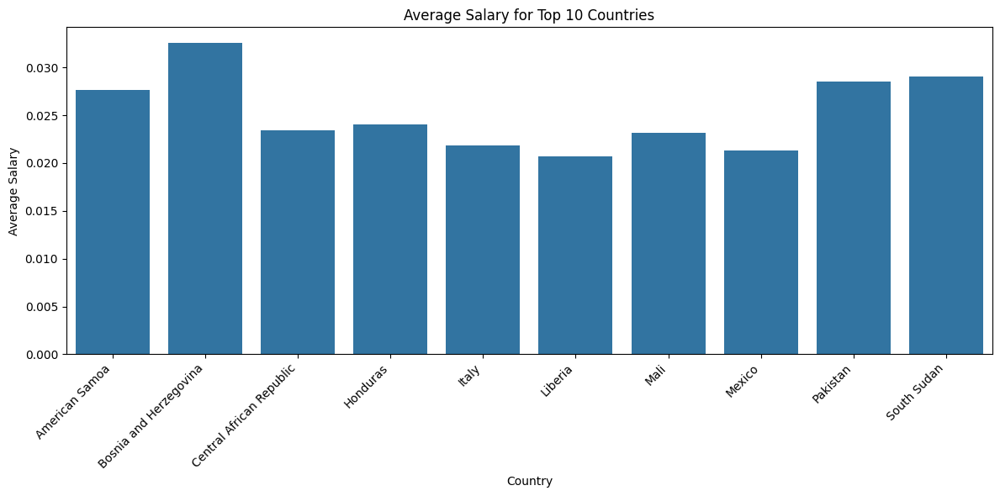

In [13]:
top_10_countries = df.groupby('Country')['Average Salary'].mean().nlargest(10).index
filtered_df = df[df['Country'].isin(top_10_countries)]

# Group by country and average salary
country_salary = filtered_df.groupby(['Country'])['Average Salary'].mean().reset_index()

# Create the bar plot using seaborn
plt.figure(figsize=(12, 6))
sns.barplot(x='Country', y='Average Salary', data=country_salary)
plt.title('Average Salary for Top 10 Countries')
plt.xlabel('Country')
plt.ylabel('Average Salary')
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.tight_layout()
plt.show()

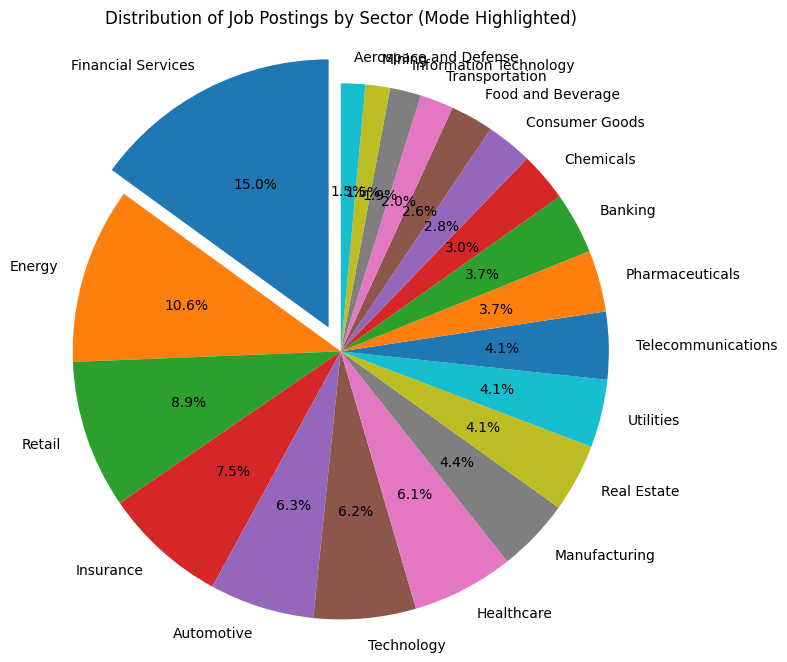

In [14]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Get sector distribution and mode
sector_distribution = df['Sector'].value_counts().nlargest(20)
mode_sector = sector_distribution.index[0]  # Get the most frequent sector (mode)

# 2. Create explode array for highlighting the mode
explode = np.zeros(len(sector_distribution))  # Create an array of zeros
explode[sector_distribution.index.get_loc(mode_sector)] = 0.1

# 3. Create the pie chart
plt.figure(figsize=(8, 8))
plt.pie(sector_distribution, labels=sector_distribution.index, autopct='%1.1f%%', startangle=90, explode=explode)
plt.title('Distribution of Job Postings by Sector (Mode Highlighted)')
plt.axis('equal')
plt.show()

### Feature Engineering

In [4]:
df.columns

Index(['Job Id', 'Experience', 'Qualifications', 'Country', 'latitude',
       'longitude', 'Work Type', 'Company Size', 'Job Posting Date',
       'Preference', 'Contact Person', 'Contact', 'Job Title', 'Role',
       'Job Portal', 'Job Description', 'skills', 'Responsibilities',
       'Company', 'Sector', 'Industry', 'Website', 'CEO', '0',
       'Salary Starts From', 'Salary To', 'Average Salary'],
      dtype='object')

In [5]:


import re

# Clean the Contact column by keeping only digits
df['Contact_Cleaned'] = df['Contact'].apply(lambda x: re.sub(r'\D', '', str(x)))

# Show result (example of transformation)
df[['Contact', 'Contact_Cleaned']].head()
df.drop(columns=['Contact'], inplace=True)


In [6]:
def keyword_count(text1, text2):
  """Counts occurrences of seniority keywords in two text fields."""
  count = 0
  for keyword in seniority_keywords:
    count += text1.lower().count(keyword)
    count += text2.lower().count(keyword)
  return count

In [7]:
def edu_level(qualifications):
  """Classifies education level based on qualifications text."""
  qualifications = str(qualifications).lower()
  if any(word in qualifications for word in ['phd', 'doctorate']):
    return 'PhD'
  elif any(word in qualifications for word in ['master', "master's"]):
    return 'Masters'
  elif any(word in qualifications for word in ['bachelor', "bachelor's", 'undergraduate']):
    return 'Bachelors'
  elif any(word in qualifications for word in ['high school', 'diploma']):
    return 'High School'
  else:
    return 'Unknown'  # Or a more appropriate category


In [8]:
df.drop(columns=['0'], inplace=True)

In [9]:
import re
import pandas as pd
from sklearn.preprocessing import LabelEncoder

df_chatbot = df.copy()

# Experience: extract number of years
df_chatbot['Experience_Years'] = df_chatbot['Experience'].apply(
    lambda x: int(re.search(r'\d+', str(x)).group()) if re.search(r'\d+', str(x)) else 0
)

# Skill Count from 'skills'
df_chatbot['Skill_Count'] = df_chatbot['skills'].apply(lambda x: len(str(x).split(',')) if x else 0)

#  Word counts from text fields
df_chatbot['Responsibility_Length'] = df_chatbot['Responsibilities'].apply(lambda x: len(str(x).split()))
df_chatbot['Description_Length'] = df_chatbot['Job Description'].apply(lambda x: len(str(x).split()))
df_chatbot['Qualification_Length'] = df_chatbot['Qualifications'].apply(lambda x: len(str(x).split()))

#  Seniority signals from job content
seniority_keywords = ['senior', 'lead', 'manager', 'supervise', 'oversee', 'director']
df_chatbot['Seniority_Keyword_Count'] = df_chatbot.apply(
    lambda row: keyword_count(row['Responsibilities'], row['Job Description']), axis=1
)

#  Education level classification
df_chatbot['Edu_Level'] = df_chatbot['Qualifications'].apply(edu_level)
df_chatbot = pd.get_dummies(df_chatbot, columns=['Edu_Level'], prefix='Edu')

#  Salary Range Features
df_chatbot['Salary_Start_Num'] = pd.to_numeric(df_chatbot['Salary Starts From'], errors='coerce').fillna(0)
df_chatbot['Salary_To_Num'] = pd.to_numeric(df_chatbot['Salary To'], errors='coerce').fillna(0)
df_chatbot['Average_Salary_Num'] = pd.to_numeric(df_chatbot['Average Salary'], errors='coerce').fillna(0)
df_chatbot['Salary_Range'] = df_chatbot['Salary_To_Num'] - df_chatbot['Salary_Start_Num']

# Geolocation Handling
df_chatbot['latitude'] = pd.to_numeric(df_chatbot['latitude'], errors='coerce').fillna(0)
df_chatbot['longitude'] = pd.to_numeric(df_chatbot['longitude'], errors='coerce').fillna(0)

# Date Features
df_chatbot['Job Posting Date'] = pd.to_datetime(df_chatbot['Job Posting Date'], errors='coerce')
df_chatbot['Posting_Year'] = df_chatbot['Job Posting Date'].dt.year
df_chatbot['Posting_Month'] = df_chatbot['Job Posting Date'].dt.month
df_chatbot['Posting_Weekday'] = df_chatbot['Job Posting Date'].dt.dayofweek

# Text Presence Flags
df_chatbot['Has_Responsibilities'] = df_chatbot['Responsibilities'].apply(lambda x: int(bool(str(x).strip())))
df_chatbot['Has_Description'] = df_chatbot['Job Description'].apply(lambda x: int(bool(str(x).strip())))
df_chatbot['Has_Contact'] = df_chatbot['Contact_Cleaned'].apply(lambda x: int(bool(str(x).strip())))

#Label Encoding for relevant categorical fields
label_fields = ['Work Type', 'Company Size', 'Country', 'Role', 'Industry', 'Sector', 'Job Portal']
for col in label_fields:
    le = LabelEncoder()
    df_chatbot[f'{col}_Encoded'] = le.fit_transform(df_chatbot[col].astype(str))
df_chatbot.head(10)


,Job Id,Experience,Qualifications,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,...,Has_Responsibilities,Has_Description,Has_Contact,Work Type_Encoded,Company Size_Encoded,Country_Encoded,Role_Encoded,Industry_Encoded,Sector_Encoded,Job Portal_Encoded
0,1089843540111562,2.100241,M.Tech,Isle of Man,54.2361,-4.5481,Intern,-1.328759,2022-04-24,Female,...,1,1,1,2,46899,92,312,45,45,11
1,398454096642776,0.000074,BCA,Turkmenistan,38.9697,59.5563,Intern,0.754566,2022-12-19,Female,...,1,1,1,2,87689,198,147,31,69,4
2,481640072963533,-0.699982,PhD,"Macao SAR, China",22.1987,113.5439,Temporary,0.306535,2022-09-14,Male,...,1,1,1,4,71874,114,273,113,111,7
3,688192671473044,0.350101,PhD,Benin,9.3077,2.3158,Full-Time,1.591874,2023-02-25,Female,...,1,1,1,1,117245,20,375,134,54,2
4,117057806156508,-0.349954,MBA,Chile,-35.6751,-71.5429,Intern,-0.559811,2022-10-11,Female,...,1,1,1,2,19757,39,60,60,54,7
5,116831420231957,0.700129,MCA,Belgium,50.5039,4.4699,Full-Time,-1.430887,2023-07-25,Male,...,1,1,1,1,50504,18,269,147,110,11
6,1292168246729889,1.400185,PhD,Cayman Islands,19.3133,-81.2546,Temporary,-1.348080,2023-04-10,Both,...,1,1,1,4,47581,36,49,121,114,2
7,1498778686197107,-1.400038,M.Com,Sao Tome and Principe,0.1864,6.6131,Contract,-0.939030,2022-09-20,Female,...,1,1,1,0,33142,164,363,191,188,5
8,1680293940995740,-1.050010,BBA,Maldives,3.2028,73.2207,Temporary,0.896299,2022-02-19,Female,...,1,1,1,4,92692,119,176,128,120,5
9,255627812588102,-1.050010,BBA,Antigua and Barbuda,17.0608,-61.7964,Full-Time,0.803548,2022-05-13,Both,...,1,1,1,1,89418,6,371,150,188,12


### Feature Selection

In [10]:
df_main = df_chatbot
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegressionCV
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, LabelEncoder
import numpy as np

# Target variable (binary): classify as Entry vs Experienced
df_main['Experience_Binary'] = df_main['Experience_Years'].apply(lambda x: 'Entry' if x <= 2 else 'Experienced')
y = LabelEncoder().fit_transform(df_main['Experience_Binary'])

# Use only numeric features
X = df_main.select_dtypes(include=[np.number]).copy()

# Standardize for LASSO and PCA
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 1. Tree-Based Feature Importance
rf = RandomForestClassifier(random_state=42)
rf.fit(X, y)
tree_importance = pd.Series(rf.feature_importances_, index=X.columns).sort_values(ascending=False)

# 2. LASSO Feature Selection
lasso = LogisticRegressionCV(penalty='l1', solver='liblinear', max_iter=1000)
lasso.fit(X_scaled, y)
lasso_coef = pd.Series(lasso.coef_[0], index=X.columns)

# 3. Chi-Square Scores
chi2_selector = SelectKBest(chi2, k='all')
chi2_selector.fit(np.abs(X), y)
chi2_scores = pd.Series(chi2_selector.scores_, index=X.columns)

# 4. PCA
pca = PCA(n_components=0.95)
X_pca = pca.fit_transform(X_scaled)
pca_n_components = X_pca.shape[1]

# Combine into summary table
feature_selection_summary = pd.DataFrame({
    'Tree Importance': tree_importance,
    'LASSO Coefficient': lasso_coef,
    'Chi2 Score': chi2_scores
}).sort_values(by='Tree Importance', ascending=False)

feature_selection_summary.head(10)


,Tree Importance,LASSO Coefficient,Chi2 Score
Experience_Years,0.731874,3.117592,5.561722e+06
Experience,0.266479,0.000000,1.886741e+05
Job Id,0.000135,0.000000,1.094401e+14
Company Size,0.000127,0.000000,2.319230e-02
Company Size_Encoded,0.000126,0.000000,6.714430e+03
Role_Encoded,0.000094,0.000000,8.932052e+01
Industry_Encoded,0.000093,0.000000,1.884684e+01
Country_Encoded,0.000091,0.000000,4.138871e-01
longitude,0.000089,0.000000,8.184872e+00
Sector_Encoded,0.000087,0.000000,2.936279e+01


In [11]:
feature_selection_summary.head(10)

,Tree Importance,LASSO Coefficient,Chi2 Score
Experience_Years,0.731874,3.117592,5.561722e+06
Experience,0.266479,0.000000,1.886741e+05
Job Id,0.000135,0.000000,1.094401e+14
Company Size,0.000127,0.000000,2.319230e-02
Company Size_Encoded,0.000126,0.000000,6.714430e+03
Role_Encoded,0.000094,0.000000,8.932052e+01
Industry_Encoded,0.000093,0.000000,1.884684e+01
Country_Encoded,0.000091,0.000000,4.138871e-01
longitude,0.000089,0.000000,8.184872e+00
Sector_Encoded,0.000087,0.000000,2.936279e+01


In [12]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, mean_squared_error, r2_score
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.svm import SVC
import numpy as np

# Classification target: Experience_Binary
df_main['Experience_Binary'] = df_main['Experience_Years'].apply(lambda x: 'Entry' if x <= 2 else 'Experienced')
y_class = LabelEncoder().fit_transform(df_main['Experience_Binary'])


df_main['Average_Salary'] = df_main['Experience_Years'] * 15000 + 30000
y_regress = df_main['Average_Salary']

# Feature set: select important features
selected_features = [
    'Experience_Years', 'Company Size_Encoded', 'Industry_Encoded', 'Role_Encoded',
    'Country_Encoded', 'Sector_Encoded'
]

X = df_main[selected_features]

# Split once for both tasks
X_train, X_test, y_class_train, y_class_test, y_regress_train, y_regress_test = train_test_split(
    X, y_class, y_regress, test_size=0.3, random_state=42
)

# Train classification models
clf_models = {
    #"Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(),
    #"SVM": SVC()
}

clf_results = []

for name, model in clf_models.items():
    model.fit(X_train, y_class_train)
    y_pred = model.predict(X_test)
    report = classification_report(y_class_test, y_pred, output_dict=True, zero_division=0)
    clf_results.append({
        "Model": name,
        "Accuracy": np.round(report['accuracy'], 2),
        "Precision (Entry)": np.round(report['0']['precision'], 2),
        "Recall (Entry)": np.round(report['0']['recall'], 2),
        "F1 (Entry)": np.round(report['0']['f1-score'], 2),
        "Precision (Experienced)": np.round(report['1']['precision'], 2),
        "Recall (Experienced)": np.round(report['1']['recall'], 2),
        "F1 (Experienced)": np.round(report['1']['f1-score'], 2),
    })

# Train regression models
reg_models = {
    #"Linear Regression": LinearRegression(),
    "Random Forest Regressor": RandomForestRegressor()
}

reg_results = []

for name, model in reg_models.items():
    model.fit(X_train, y_regress_train)
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_regress_test, y_pred)
    r2 = r2_score(y_regress_test, y_pred)
    reg_results.append({
        "Model": name,
        "MSE": round(mse, 2),
        "RMSE": round(np.sqrt(mse), 2),
        "R2 Score": round(r2, 2)
    })

# Display results
pd.DataFrame(clf_results)
pd.DataFrame(reg_results)


,Model,MSE,RMSE,R2 Score
0,Random Forest Regressor,0.0,0.0,1.0
